In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import os
import subprocess as sp
from tqdm import tqdm 
import gtfparse

import seaborn as sns
import sys

sys.path.append('/project2/mstephens/cfbuenabadn/gtex-stm/code/scripts')
from plot_gtf import *

In [2]:
lm_path = 'ebpmf_models/tables/'
gene_list = os.listdir(lm_path)
genes_with_lm_K3 = [gene for gene in gene_list if os.path.isfile(lm_path + f'{gene}/lm_K3.tab.gz')]
genes_with_lm_K2 = [gene for gene in gene_list if os.path.isfile(lm_path + f'{gene}/lm_K2.tab.gz')]

tissues = "Brain_Anterior_cingulate_cortex_BA24:Muscle_Skeletal"
def lm_pvals(gene, tissues, K):
    command = 'zcat {lm_file} | grep "{tissues}"'
        
    lm_file = lm_path + f'{gene}/lm_K{str(K)}.tab.gz'
    command_run = command.format(lm_file=lm_file, tissues=tissues)
    lm_output = sp.check_output(command_run, shell=True).decode()
    rows_ = lm_output.rstrip().split('\n')
    
    fast_pval_list = []
    sgom_pval_list = []
    fast_slope_list = []
    sgom_slope_list = []
    factor_list = []
    
    for row_ in rows_:
        pval_list = row_.rstrip().split('\t')
        fast_pval_list.append(float(pval_list[2]))
        sgom_pval_list.append(float(pval_list[4]))
        fast_slope_list.append(float(pval_list[6]))
        sgom_slope_list.append(float(pval_list[8]))
        factor_list.append(pval_list[9])

    return fast_pval_list, sgom_pval_list, fast_slope_list, sgom_slope_list, factor_list

In [3]:
fast_pval_list = []
sgom_pval_list = []
fast_slope_list = []
sgom_slope_list = []
factor_list = []
gene_list = []

for gene in tqdm(genes_with_lm_K2):
    fast_pval, sgom_pval, fast_slope, sgom_slope, factor = lm_pvals(gene, tissues, K=2)
    fast_pval_list.extend(fast_pval)
    sgom_pval_list.extend(sgom_pval)
    fast_slope_list.extend(fast_slope)
    sgom_slope_list.extend(sgom_slope)
    factor_list.extend(factor)
    gene_list.extend([gene]*2)
    
df_pvals = pd.DataFrame({'gene':gene_list, 
                         'fast_pval':fast_pval_list, 
                         'sgom_pval':sgom_pval_list,
                         'fast_slope':fast_slope_list, 
                         'sgom_slope':sgom_slope_list,
                         'factor':factor_list
                        })
df_pvals = df_pvals.set_index('gene')
genes_K2 = df_pvals.groupby('gene').fast_pval.min().sort_values()[:50].index

fast_pval_list = []
sgom_pval_list = []
fast_slope_list = []
sgom_slope_list = []
factor_list = []
gene_list = []

for gene in tqdm(genes_with_lm_K3):
    fast_pval, sgom_pval, fast_slope, sgom_slope, factor = lm_pvals(gene, tissues, K=3)
    fast_pval_list.extend(fast_pval)
    sgom_pval_list.extend(sgom_pval)
    fast_slope_list.extend(fast_slope)
    sgom_slope_list.extend(sgom_slope)
    factor_list.extend(factor)
    gene_list.extend([gene]*3)
    
df_pvals = pd.DataFrame({'gene':gene_list, 
                         'fast_pval':fast_pval_list, 
                         'sgom_pval':sgom_pval_list,
                         'fast_slope':fast_slope_list, 
                         'sgom_slope':sgom_slope_list,
                         'factor':factor_list
                        })
df_pvals = df_pvals.set_index('gene')
genes_K3 = df_pvals.groupby('gene').fast_pval.min().sort_values()[:50].index

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3459/3459 [01:41<00:00, 34.04it/s]


In [4]:
# from statsmodels.stats.multitest import multipletests
# fast_multitest = multipletests(df_pvals.fast_pval, alpha=0.01)
# sgom_multitest = multipletests(df_pvals.sgom_pval, alpha=0.01)
# df_pvals['fast_fdr'] = fast_multitest[1]
# df_pvals['sgom_fdr'] = sgom_multitest[1]
# df_pvals['fast_sig'] = fast_multitest[0]
# df_pvals['sgom_sig'] = sgom_multitest[0]

In [5]:
def plot_factors(gene, K, onerow=False, fill=False, smooth = False):
    EF = pd.read_csv(f'ebpmf_models/tables/{gene}/ebpmf_K{str(K)}/EF.tab.gz', sep='\t', index_col=0)
    EF_smooth = pd.read_csv(f'ebpmf_models/tables/{gene}/ebpmf_K{str(K)}/EF_smooth.tab.gz', sep='\t', index_col=0)
    col_names = [f'factor{str(i+1)}' for i in range(K)]
    EF.columns = col_names
    EF_smooth.columns = col_names

    EF = EF.iloc[1:(len(EF)-1)]
    EF_smooth = EF_smooth.iloc[1:(len(EF_smooth)-1)]
    EF_smooth.index = EF.index
    gtf_exons, cds = get_gene_gtf(gtf_df, gene)
    gene_name = gtf_df.loc[gtf_df.gene_id==gene].gene_name.iloc[0]
    if onerow:
        plot_gene_onerow(EF_smooth, gtf_df, gene, K, f'{gene_name}, fasttopics ini')
        plt.savefig(f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.K{str(K)}.factors_onerow.png', dpi=500, bbox_inches='tight')
    else:
        plot_gene(EF_smooth, gtf_df, gene, K, f'{gene_name}, fasttopics ini', fill=fill, smooth=smooth)
        if smooth:
            plt.savefig(f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.K{str(K)}.factors_smooth.png', 
                        dpi=500, bbox_inches='tight')
        else:
            plt.savefig(f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.K{str(K)}.factors.png', 
                        dpi=500, bbox_inches='tight')
    
def plot_factors_sgom(gene, K, onerow=False, fill=False):
    EF = pd.read_csv(f'ebpmf_models/tables/{gene}/ebpmf_K{str(K)}/EF.tab.gz', sep='\t', index_col=0)
    EF_smooth = pd.read_csv(f'ebpmf_models/tables/{gene}/ebpmf_sgom_K{str(K)}/EF_smooth.tab.gz', sep='\t', index_col=0)
    col_names = [f'factor{str(i+1)}' for i in range(K)]
    EF.columns = col_names
    EF_smooth.columns = col_names

    EF = EF.iloc[1:(len(EF)-1)]
    EF_smooth = EF_smooth.iloc[1:(len(EF_smooth)-1)]
    EF_smooth.index = EF.index
    gtf_exons, cds = get_gene_gtf(gtf_df, gene)
    gene_name = gtf_df.loc[gtf_df.gene_id==gene].gene_name.iloc[0]
    if onerow:
        plot_gene_onerow(EF_smooth, gtf_df, gene, K, f'{gene_name}, fasttopics ini')
        plt.savefig(f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.factors_onerow.K{str(K)}.png', dpi=500, bbox_inches='tight')
    else:
        plot_gene(EF_smooth, gtf_df, gene, K, f'{gene_name}, fasttopics ini', fill=fill)
        plt.savefig(f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.K{str(K)}.factors.png', dpi=500, bbox_inches='tight')



def smooth_factor(factor, cutoff=0.2, smooth_fraction = 0.2, step_fraction = 10, exon_quant = 1, cutoff_strict = 0.1):
    factor = factor/(np.max(factor))
    
    step = int(len(factor)/step_fraction)
    
    factor_smooth = []
    for idx, f in enumerate(factor):
        if f <= cutoff_strict:
            f_smooth = 0
            
        if (idx >= 1) and (factor_smooth[idx-1] == 0) and (f < cutoff):
            f_smooth = 0
        elif (idx < step) :
            if (f < cutoff):
                f_smooth = 0
            else:
                f_smooth = 1
        elif (idx > step):
            f_ref = idx-step
            f_last = idx-1
            
            f_exon_peak = np.quantile(factor[f_ref:f_last], exon_quant)
            
            if (f < (f_exon_peak*smooth_fraction)):
                f_smooth = 0
            else:
                f_smooth = 1
        else:
            f_smooth = 1
            
        factor_smooth.append(f_smooth)
    
    factor_smooth = np.array(factor_smooth)
    
    return factor_smooth

def plot_counts(gene, title, log=True):
    counts = pd.read_csv(f'coverage/count_tables/{gene}.tab.gz', sep='\t', index_col=0)
    test_samples = [x for x in counts.index if x.endswith('.test')]
    counts = counts.loc[test_samples]
    counts.index = [x.rstrip('.test') for x in counts.index]
    plot_coverage(gene, gtf_df, counts,
              tissue_list = ["Brain_Anterior_cingulate_cortex_BA24", "Muscle_Skeletal"], title=title, log=log)
    if not log:
        plt.savefig(f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.coverage.png', dpi=500, bbox_inches='tight')
    else:
        plt.savefig(f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.log_coverage.png', dpi=500, bbox_inches='tight')

def plot_gene_onerow(EF, gtf, gene, K, title=None):
    gtf_exons, cds = get_gene_gtf(gtf_df, gene)
    colores = sns.color_palette("tab10")
    
    fig, ax = plt.subplots(nrows = 2, figsize=(10, 2*0.75), gridspec_kw={'height_ratios': [2, 3], 
                                                                           'wspace': 0.3, 'hspace': 0.3})

    start = int(EF.index[0].split(':')[1])
    end = int(EF.index[-1].split(':')[1])
    length = EF.shape[0]
    
    coords = np.linspace(start, end, num=length)
    
    for i in range(K):
        factor = f'factor{i+1}'
        scaled_y = EF[factor]/np.max(EF[factor])
        ax[0].plot(coords, scaled_y, c=colores[i], alpha=0.6)
        ax[0].set_xticks([])
        ax[0].spines['bottom'].set_visible(False)
        ax[0].spines['top'].set_visible(False)
        ax[0].spines['right'].set_visible(False)
        
        #ax[i].text(start+(length*0.9), 0.9, factor, size=12)
        
    if title:
        fig.suptitle(title, fontsize=12, x=0.5, y=1.1)

    PlotGene(gtf_exons, plot_cds=False, collapse_transcripts=False, plot_nmd=True, ax=ax[1])
    ax[1].set_xlim(ax[0].get_xlim())
    
#     plt.show()
def plot_gene(EF, gtf, gene, K, title=None, fill=True, smooth=False):
    gtf_exons, cds = get_gene_gtf(gtf_df, gene)
    colores = sns.color_palette("tab10")
    
#     if K == 2:
#         S = 4*0.75
    if K <= 3:
        S = K
    else:
        S = K*0.8
    
    fig, ax = plt.subplots(nrows = K+1, figsize=(10, S), gridspec_kw={'height_ratios': [2]*K + [3], 
                                                                           'wspace': 0.3, 'hspace': 0.3})

    start = int(EF.index[0].split(':')[1])
    end = int(EF.index[-1].split(':')[1])
    length = EF.shape[0]
    
    coords = np.linspace(start, end, num=length)
    
    for i in range(K):
        factor = f'factor{i+1}'
        scaled_y = EF[factor]/np.max(EF[factor])
        if fill:
            ax[i].fill_between(coords, np.zeros(len(coords)), scaled_y, color=colores[i])
        else:
            if smooth:
                scaled_y = smooth_factor(scaled_y)
            ax[i].plot(coords, scaled_y, c=colores[i], alpha=0.9)
        ax[i].set_xticks([])
        ax[i].spines['bottom'].set_visible(False)
        ax[i].spines['top'].set_visible(False)
        ax[i].spines['right'].set_visible(False)
        
        ax[i].text(start+((end-start)*0.9), 0.9, factor, size=12)
        
    if title:
        fig.suptitle(title, fontsize=12, x=0.5, y=1.1)

    PlotGene(gtf_exons, plot_cds=False, collapse_transcripts=False, plot_nmd=True, ax=ax[K])
    ax[K].set_xlim(ax[0].get_xlim())
    
#     plt.show()
def plot_coverage(gene, gtf, counts, tissue_list, title=None, log=True):
    gtf_exons, cds = get_gene_gtf(gtf_df, gene)
    colores = sns.color_palette("tab10")
    
#     tissues = sorted(os.listdir('coverage/counts_tables/'))
    
    fig, ax = plt.subplots(nrows = (len(tissue_list)+1), figsize=(10, len(tissue_list)), 
                           gridspec_kw={'height_ratios': [2]*len(tissue_list) + [3], 
                                                                           'wspace': 0.3, 'hspace': 0.3})
    if log:
        counts = np.log1p(counts)

    start = int(counts.columns[0].split(':')[1])
    end = int(counts.columns[-1].split(':')[1])
    length = counts.shape[1]

    coords = np.linspace(start, end, num=length)
    
    for i, tissue in enumerate(tissue_list):
        
        tissue_idx = samples.loc[samples.tissue_id==tissue].index.intersection(counts.index)
    
        for idx, row in counts.loc[tissue_idx].iterrows():
            y = np.array(row)
            
            scaled_y = y/np.max(y)
            ax[i].plot(coords, scaled_y, c=colores[i], alpha=0.2, rasterized=True)
        
        ax[i].set_xticks([])
        ax[i].spines['bottom'].set_visible(False)
        ax[i].spines['top'].set_visible(False)
        ax[i].spines['right'].set_visible(False)
        
        if log:
            ax[i].set_ylabel('log1p\ncounts', size=9)
        else:
            ax[i].set_ylabel('counts', size=9)
        
        ax[i].text(start+((end-start)*0.65), 0.9, tissue, size=12)
        
    if title:
        fig.suptitle(title, fontsize=12)
    

    PlotGene(gtf_exons, plot_cds=False, collapse_transcripts=False, plot_nmd=True, ax=ax[len(tissue_list)])
    ax[len(tissue_list)].set_xlim(ax[0].get_xlim())
    
#     plt.show()


In [6]:
def get_gene_gtf(gtf_df, gene):
    try:
        gtf_gene = gtf_df.loc[gtf_df.gene_id==gene]
    except:
        gtf_gene = gtf_df.loc[gtf_df.gene_name==gene]
    gtf_exons = gtf_gene.loc[gtf_gene.feature=='exon']
    strand = gtf_gene.strand.iloc[0]
    
    if strand == '+':
        start = gtf_gene.loc[gtf_gene.feature=='start_codon'].start.min()
        stop = gtf_gene.loc[gtf_gene.feature=='stop_codon'].end.max()
    else:
        start = gtf_gene.loc[gtf_gene.feature=='stop_codon'].start.min()
        stop = gtf_gene.loc[gtf_gene.feature=='start_codon'].end.max()
    
    cds = (start, stop)
    
    return gtf_exons, cds

# # Load GTF file
gtf_file = 'Annotations/gencode.v34.primary_assembly.annotation.gtf'#'Annotations/gencode.v43.basic.annotation.gtf'

# # Parse GTF file to DataFrame
gtf_df = gtfparse.read_gtf(gtf_file)

gtf_df.gene_id = [x.split('.')[0] for x in gtf_df.gene_id]

INFO:root:Extracted GTF attributes: ['gene_id', 'gene_type', 'gene_name', 'level', 'hgnc_id', 'havana_gene', 'transcript_id', 'transcript_type', 'transcript_name', 'transcript_support_level', 'tag', 'havana_transcript', 'exon_number', 'exon_id', 'ont', 'protein_id', 'ccdsid']


/tmp/ipykernel_3731569/2234946404.py:134: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows = K+1, figsize=(10, S), gridspec_kw={'height_ratios': [2]*K + [3],


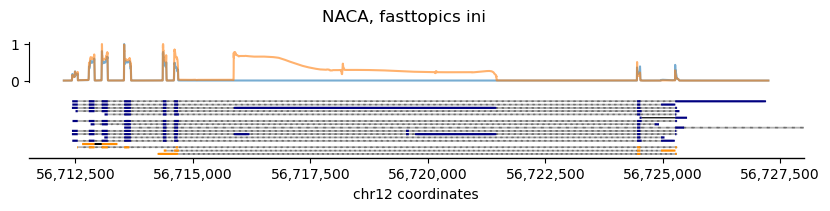

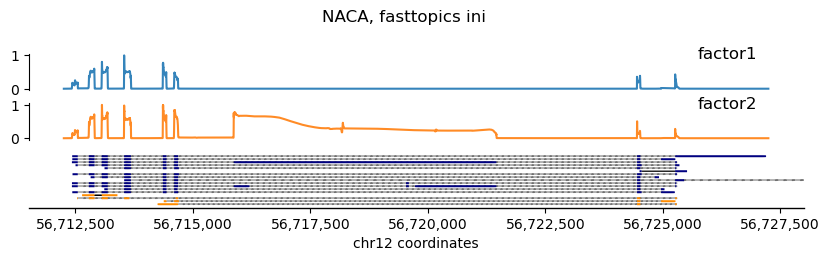

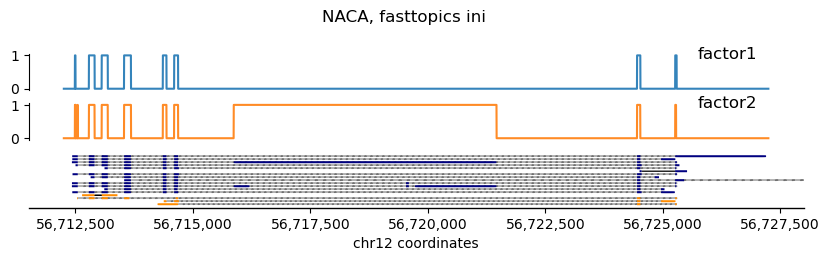

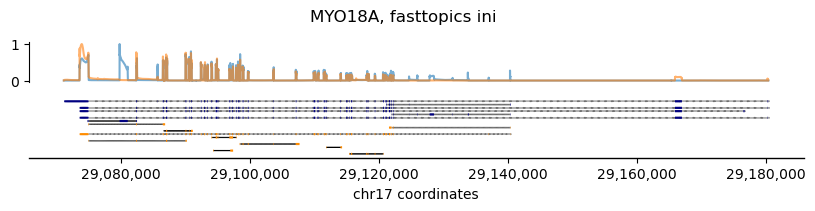

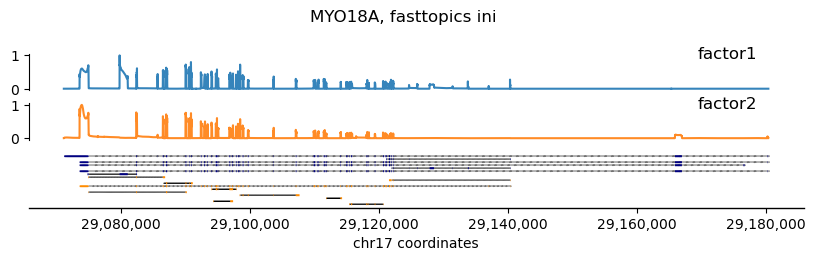

...

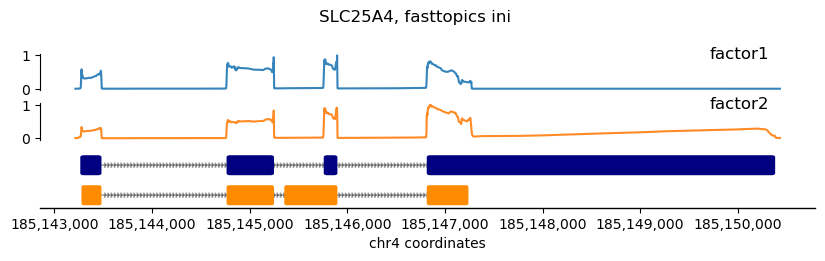

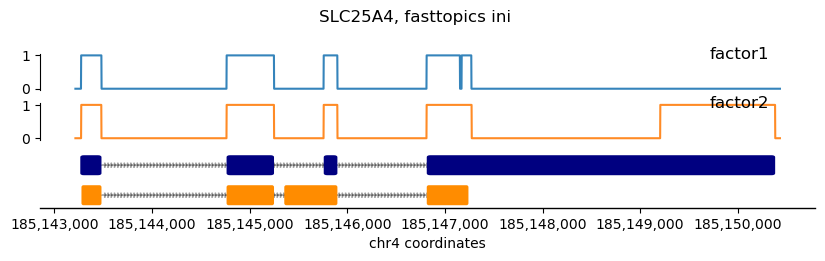

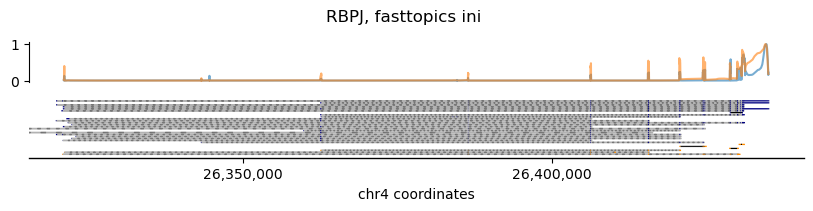

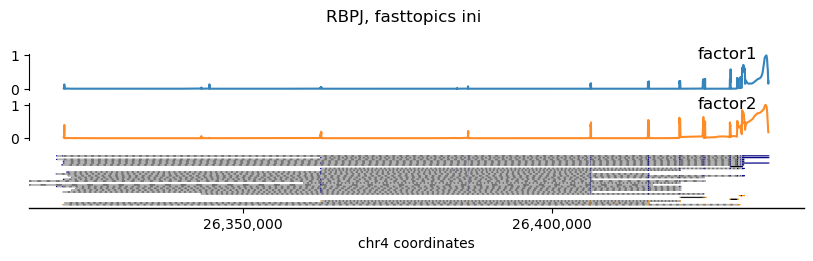

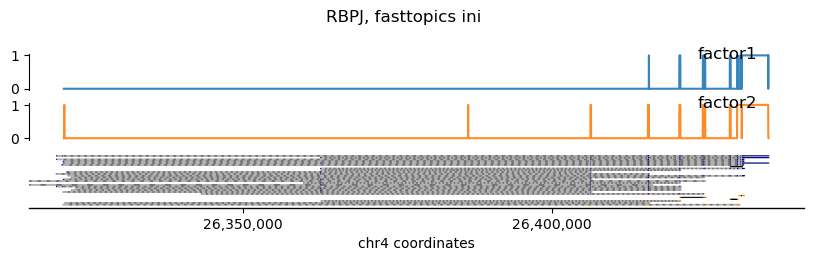

In [59]:
samples = pd.read_csv('config/samples.tsv', sep='\t', index_col=0)
for gene in genes_K2:
    plot_factors(gene, K=2, onerow=True)
    plot_factors(gene, K=2,)
#     gene_name = gtf_df.loc[gtf_df.gene_id==gene].gene_name.iloc[0]
#     plot_counts(gene, title=f'{gene_name} counts, log1p', log=True)
#     plot_counts(gene, title=f'{gene_name} counts', log=False)
    plot_factors(gene, K=2, onerow=False, fill=False, smooth=True)
    
# for gene in genes_K3:
#     plot_factors(gene, K=3,)
#     plot_factors(gene, K=3, onerow=False, fill=False, smooth=True)

/tmp/ipykernel_3731569/2632421612.py:172: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows = (len(tissue_list)+1), figsize=(10, len(tissue_list)),


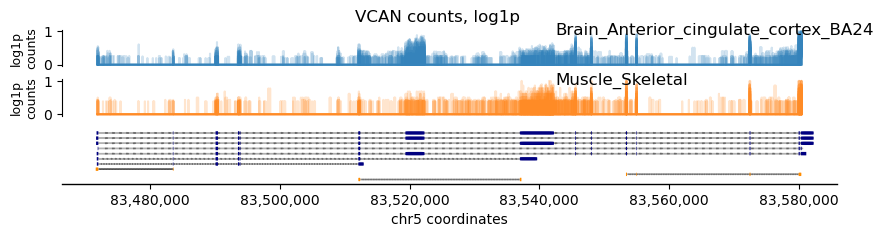

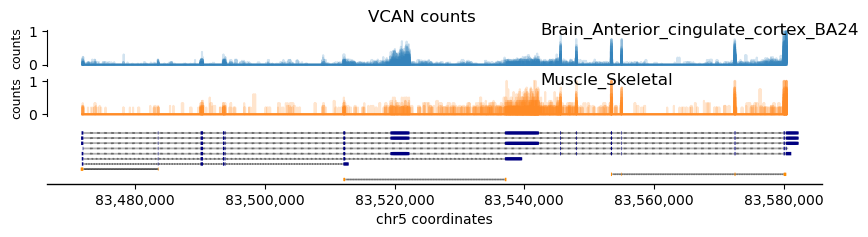

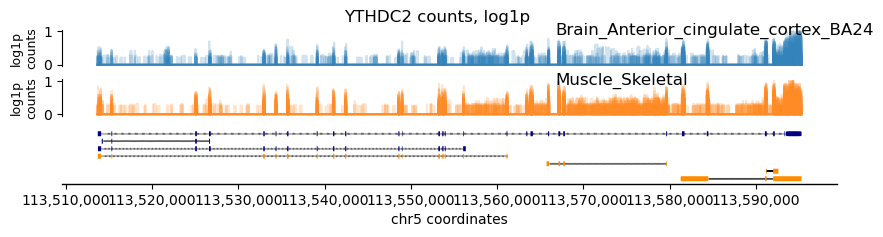

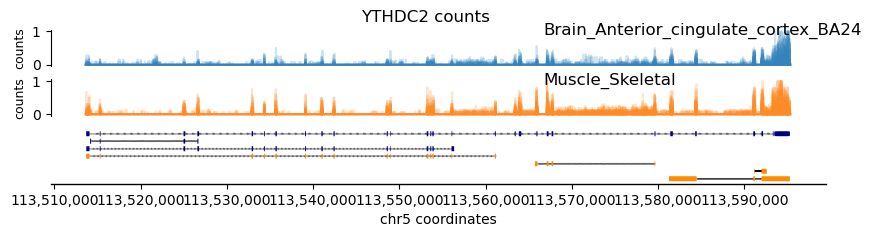

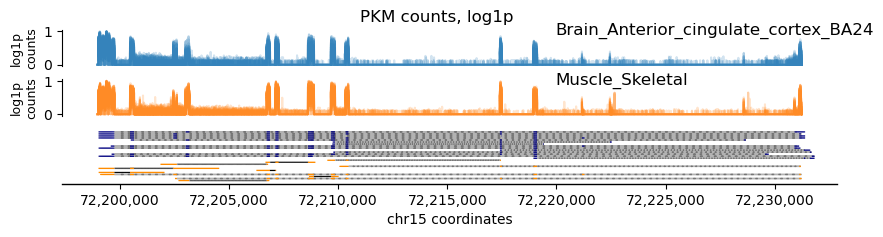

...

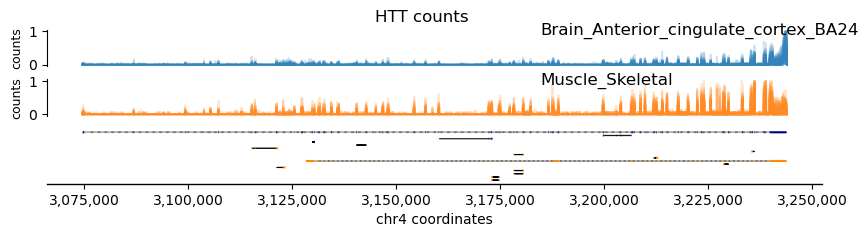

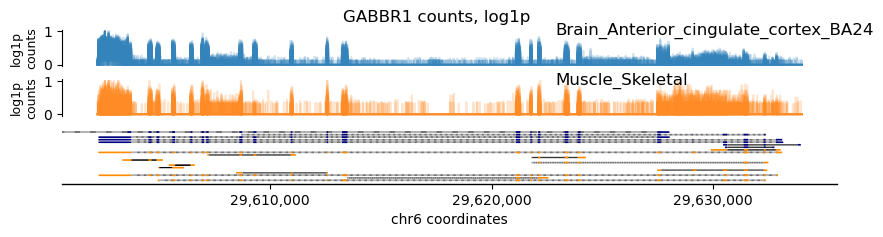

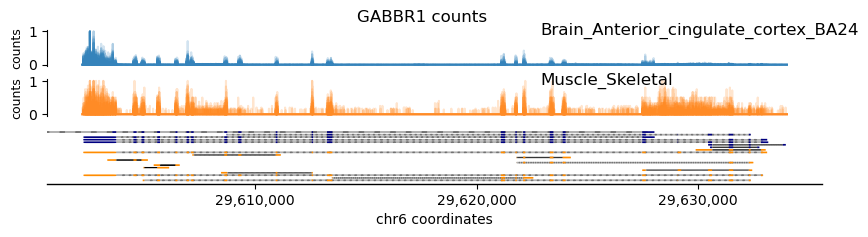

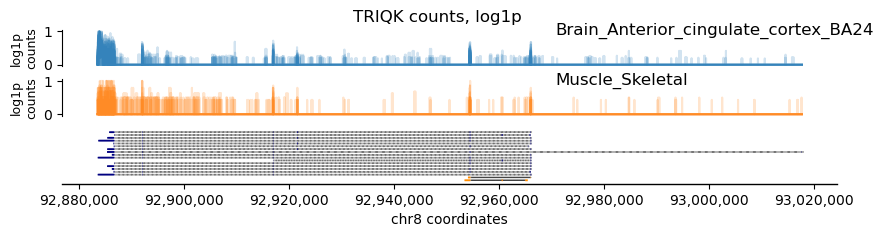

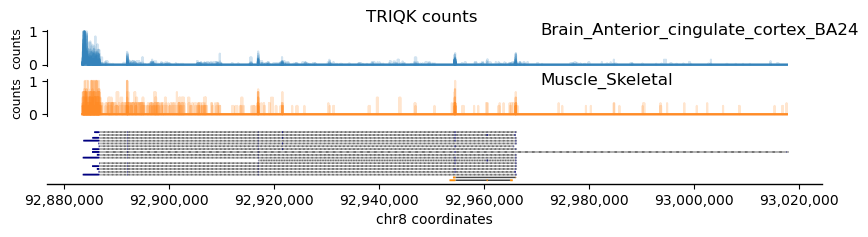

In [51]:
for gene in sorted(set(list(genes_K2) + list(genes_K3) + ['ENSG00000112081', 'ENSG00000067225'])):
    gene_name = gtf_df.loc[gtf_df.gene_id==gene].gene_name.iloc[0]
    plot_counts(gene, title=f'{gene_name} counts, log1p', log=True)
    plot_counts(gene, title=f'{gene_name} counts', log=False)


/tmp/ipykernel_3731569/858646040.py:134: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows = K+1, figsize=(10, S), gridspec_kw={'height_ratios': [2]*K + [3],


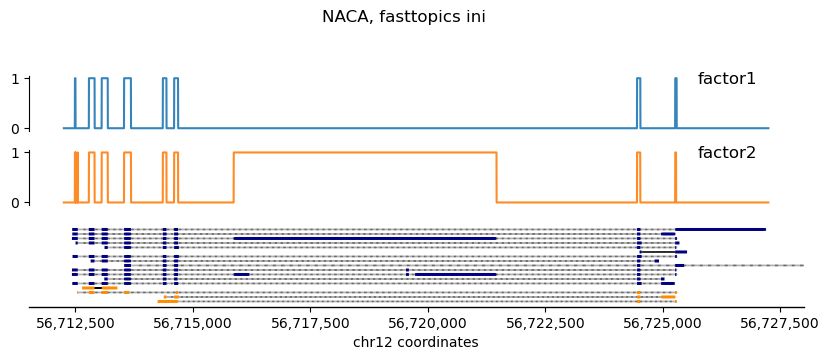

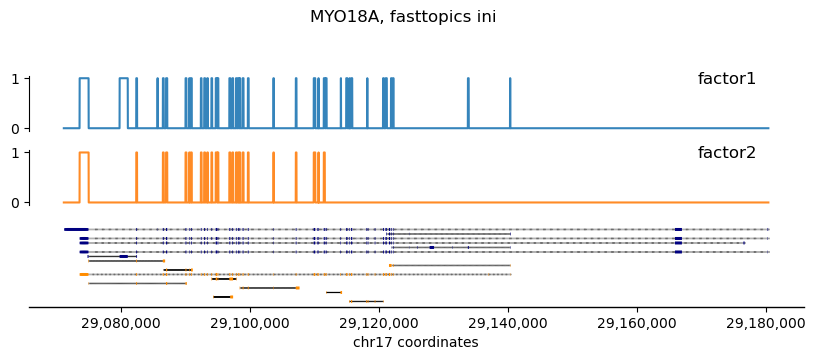

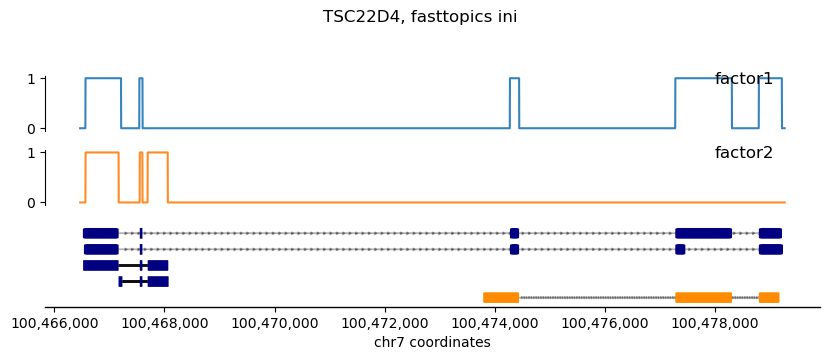

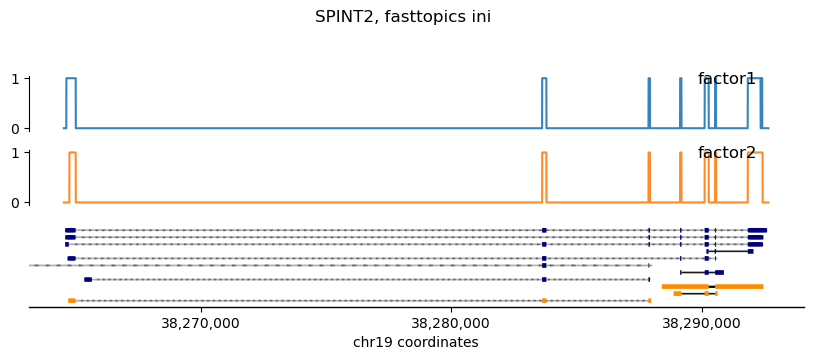

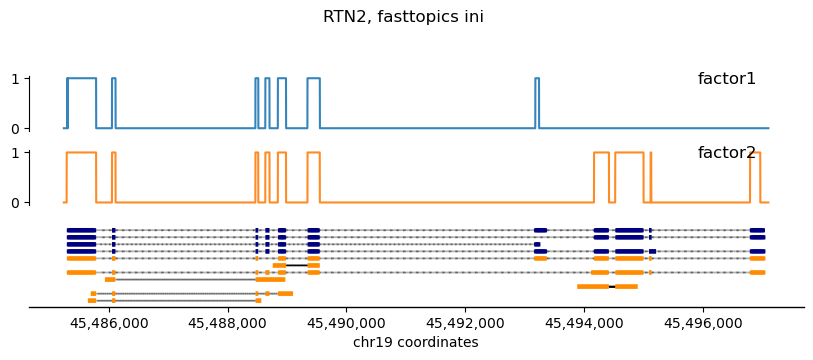

...

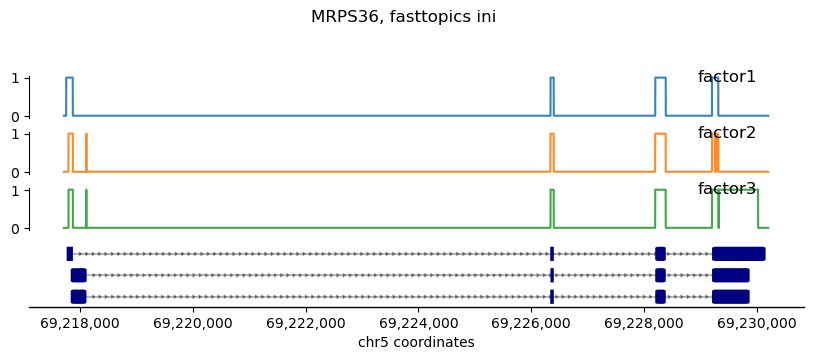

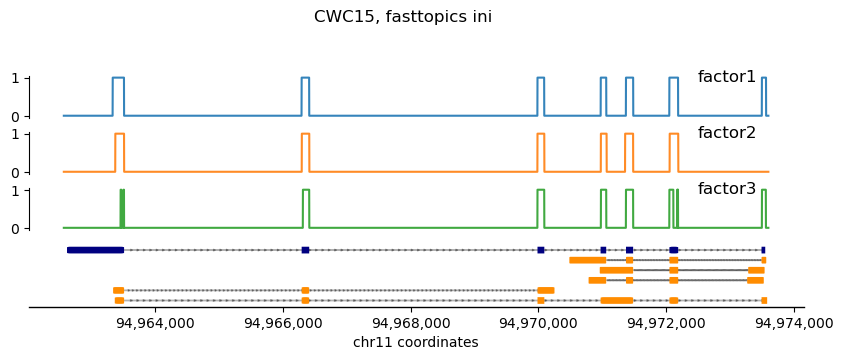

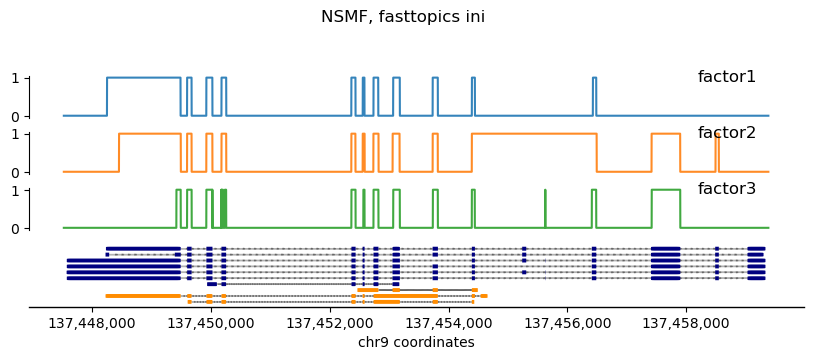

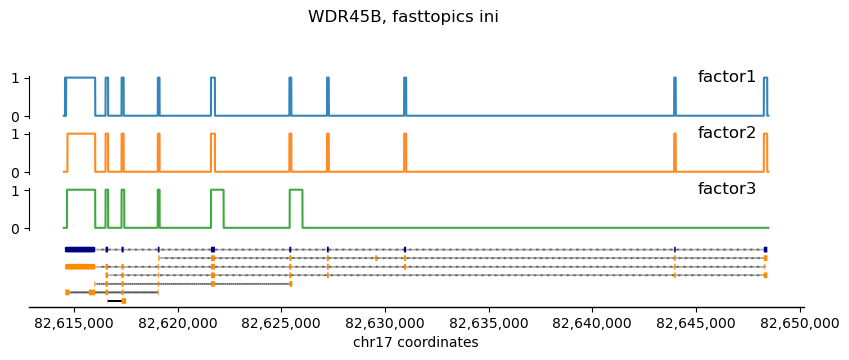

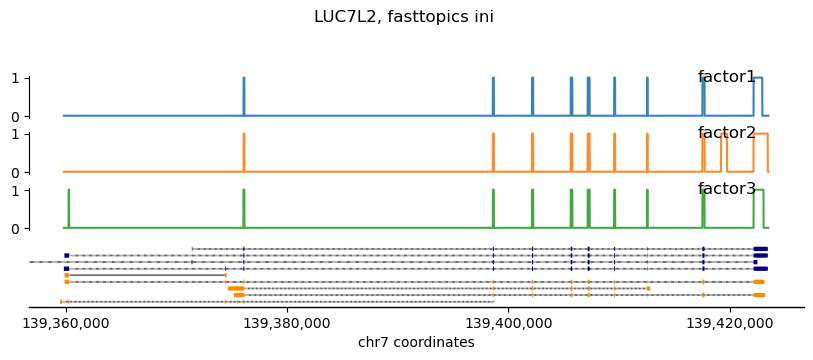

In [34]:
samples = pd.read_csv('config/samples.tsv', sep='\t', index_col=0)
for gene in genes_K2:
    plot_factors(gene, K=2, onerow=False, fill=False, smooth=True)

    
for gene in genes_K3:
    plot_factors(gene, K=3, onerow=False, fill=False, smooth=True)

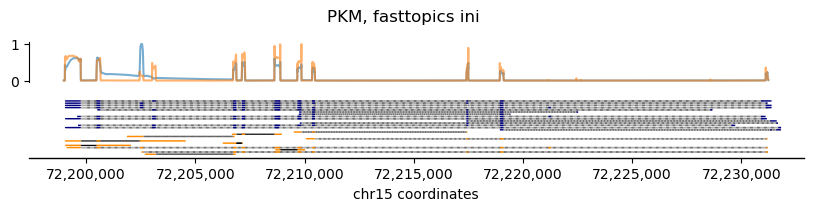

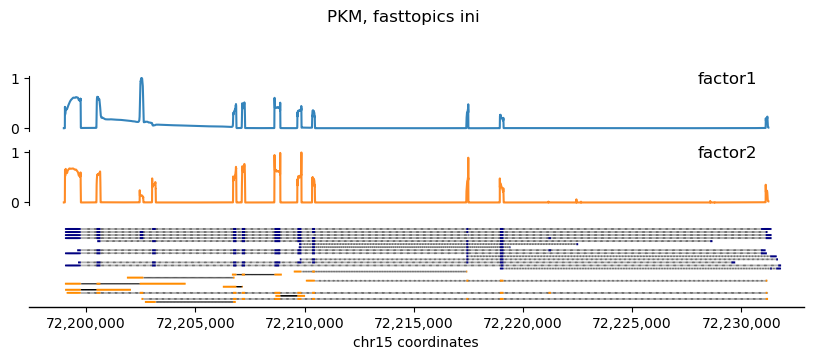

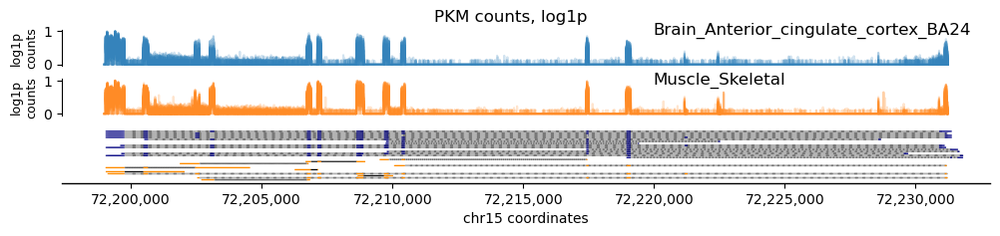

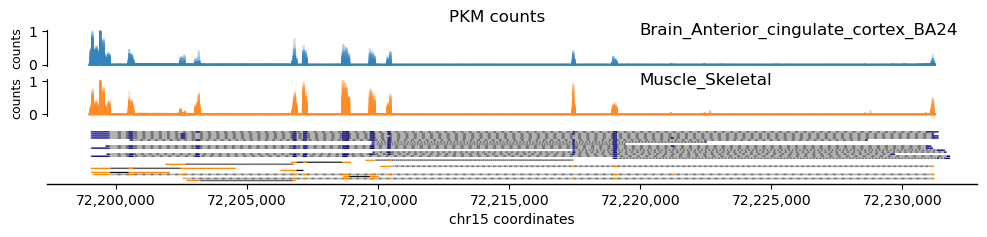

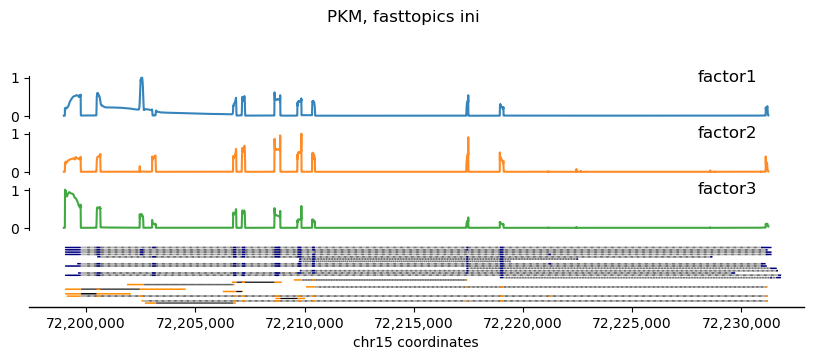

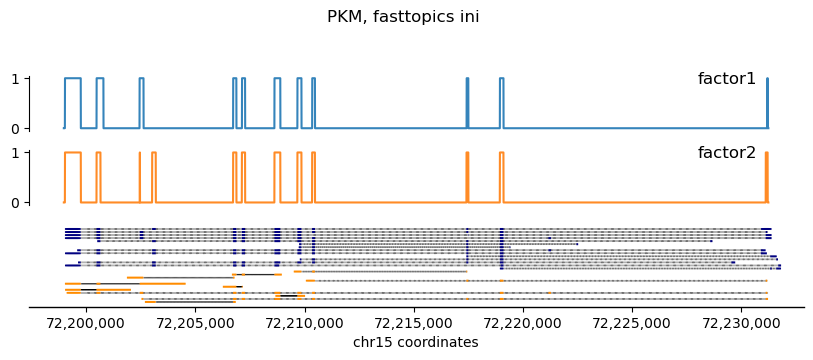

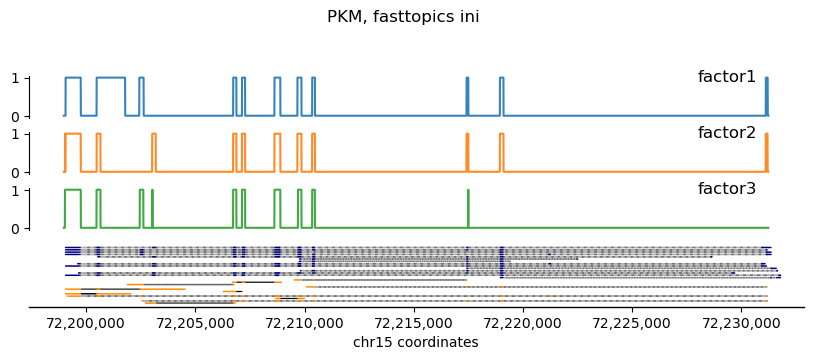

In [36]:
sr3 = ['ENSG00000112081', 'ENSG00000067225']
for gene in sr3:
    plot_factors(gene, K=2, onerow=True)
    plot_factors(gene, K=2,)
    gene_name = gtf_df.loc[gtf_df.gene_id==gene].gene_name.iloc[0]
    plot_counts(gene, title=f'{gene_name} counts, log1p', log=True)
    plot_counts(gene, title=f'{gene_name} counts', log=False)
    plot_factors(gene, K=3,)
    plot_factors(gene, K=2, onerow=False, fill=False, smooth=True)
    plot_factors(gene, K=3, onerow=False, fill=False, smooth=True)

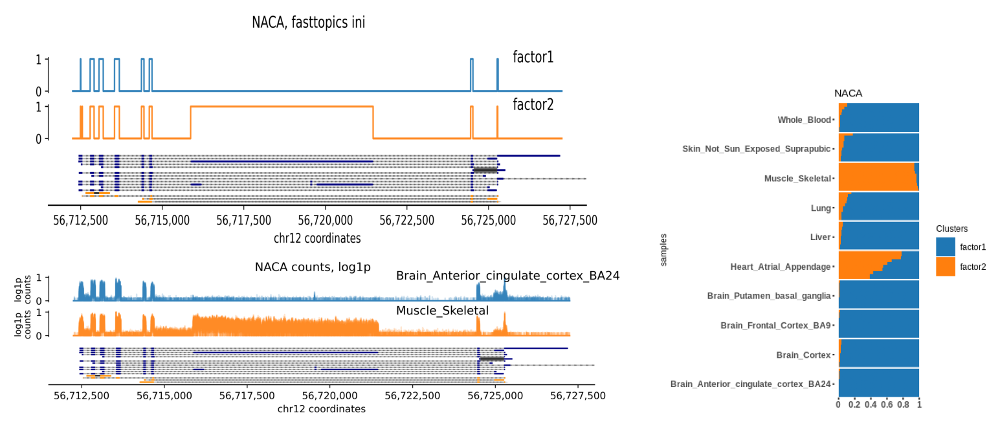

In [63]:
from matplotlib import pyplot as plt
# image = plt.imread('image.png')

png_file1 = '/project2/yangili1/cfbuenabadn/stm_top/plots/ENSG00000196531.K2.factors_smooth.png'
png_file2 = '/project2/yangili1/cfbuenabadn/stm_top/plots/ENSG00000196531.log_coverage.png'
png_file3 = '/project2/yangili1/cfbuenabadn/stm_top/plots/ENSG00000196531.K2.structure.png'

# Create a figure with three axes
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

# Create a 1x3 grid with specified width ratios
fig = plt.figure(figsize=(16, 8))
gs = gridspec.GridSpec(4, 4, hspace=0, wspace=0, width_ratios=[2, 2, 1, 1], height_ratios=[1, 2, 2, 1])

# Create axes for the left two plots
ax1 = plt.subplot(gs[:2,:2])
ax2 = plt.subplot(gs[2,:2])

# Create an axis for the right plot
ax3 = plt.subplot(gs[:,2:])


for ax in ax1, ax2, ax3:
#     ax.set_xtics([])
    ax.set_xticks([])
    ax.set_yticks([])
    for side in 'right', 'left', 'top', 'bottom':
        ax.spines[side].set_visible(False)

img1 = plt.imread(png_file1)
        
# extent = (0, img1.shape[1], 0, img1.shape[0])

ax1.imshow(img1, extent=extent)  # You may need to customize the cmap and page number

ax2.imshow(plt.imread(png_file2))  # You may need to customize the cmap and page number

ax3.imshow(plt.imread(png_file3))  # You may need to customize the cmap and page number


plt.tight_layout()

# Show the plot
plt.show()


In [5]:
from matplotlib import pyplot as plt
# image = plt.imread('image.png')

def merged_plot(gene, K):

    png_file0 = f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.K{str(K)}.factors.png'

    png_file1 = f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.K{str(K)}.factors_smooth.png'
    # png_file2 = '/project2/yangili1/cfbuenabadn/stm_top/plots/ENSG00000196531.K2.factors_onerow.png'
    png_file2 = f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.log_coverage.png'
    png_file3 = f'/project2/yangili1/cfbuenabadn/stm_top/plots/{gene}.K{str(K)}.structure.png'

    # Create a figure with three axes
    import matplotlib.pyplot as plt
    import matplotlib.gridspec as gridspec

    # Create a 1x3 grid with specified width ratios
    fig = plt.figure(figsize=(16, 10))
    gs = gridspec.GridSpec(5, 4, hspace=0, wspace=0, width_ratios=[2, 2, 1, 1], height_ratios=[1,2, 2, 2, 1])

    # Create axes for the left two plots
    ax0 = plt.subplot(gs[1,:2])
    ax1 = plt.subplot(gs[2,:2])
    ax2 = plt.subplot(gs[3,:2])

    # Create an axis for the right plot
    ax3 = plt.subplot(gs[:,2:])


    for ax in ax0, ax1, ax2, ax3:
    #     ax.set_xtics([])
        ax.set_xticks([])
        ax.set_yticks([])
        for side in 'right', 'left', 'top', 'bottom':
            ax.spines[side].set_visible(False)

    # img1 = plt.imread(png_file1)

    # extent = (0, img1.shape[1], 0, img1.shape[0])
    ax0.imshow(plt.imread(png_file0)) 

    ax1.imshow(plt.imread(png_file1))  # You may need to customize the cmap and page number

    ax2.imshow(plt.imread(png_file2))  # You may need to customize the cmap and page number

    ax3.imshow(plt.imread(png_file3))  # You may need to customize the cmap and page number

    ax3.text(20, 215, 'Muscle Skeletal', size=16, rotation=90)
    ax3.text(20, 410, 'Brain Anterior', size=16, rotation=90)

    plt.tight_layout()
    plt.savefig(f'/project2/yangili1/cfbuenabadn/stm_top/merged_plots/K{str(K)}/{gene}.png', dpi=500, bbox_inches='tight')

# Show the plot


In [ ]:
samples = pd.read_csv('config/samples.tsv', sep='\t', index_col=0)
for gene in tqdm(list(genes_K2) + ['ENSG00000112081', 'ENSG00000067225']):
    merged_plot(gene, K=2)

    
for gene in tqdm(list(genes_K3) + ['ENSG00000112081', 'ENSG00000067225']):
    merged_plot(gene, K=3)

 38%|███████████████████████████████████████████████████████████▏                                                                                              | 20/52 [01:54<03:02,  5.70s/it]/tmp/ipykernel_3833991/1426626000.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(16, 10))
 56%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                    | 29/52 [03:21<02:35,  6.78s/it]

In [7]:
import tabix
from pybedtools import BedTool

def read_EF(gene, K):
    EF = pd.read_csv(f'ebpmf_models/tables/{gene}/ebpmf_K{str(K)}/EF.tab.gz', sep='\t', index_col=0)
    EF_smooth = pd.read_csv(f'ebpmf_models/tables/{gene}/ebpmf_K{str(K)}/EF_smooth.tab.gz', sep='\t', index_col=0)
    col_names = [f'factor{str(i+1)}' for i in range(K)]
    EF.columns = col_names
    EF_smooth.columns = col_names

    EF = EF.iloc[1:(len(EF)-1)]
    EF_smooth = EF_smooth.iloc[1:(len(EF_smooth)-1)]
    EF_smooth.index = EF.index
    
    return EF_smooth

def smooth_EF(EF):
    
    EF_smooth = pd.DataFrame()
    for factor in EF.columns:
        f_smooth = smooth_factor(EF[factor])
        EF_smooth[factor] = f_smooth
        
    EF_smooth.index = EF.index
    
    return EF_smooth

def smooth_factor(factor, cutoff=0.2, smooth_fraction = 0.25, step_fraction = 10, exon_quant = 1, cutoff_strict = 0.1):
    factor = factor/(np.max(factor))
    step =int(len(factor)/step_fraction)
    
    print(step)
    
    factor_smooth = []
    for idx, f in enumerate(factor):
        if f <= cutoff_strict:
            f_smooth = 0
            
        if (idx >= 1) and (factor_smooth[idx-1] == 0) and (f < cutoff):
            f_smooth = 0
        elif (idx < step) :
            
            if (idx < 100):
            
                if (f < cutoff):
                    f_smooth = 0
                else:
                    f_smooth = 1
            else:
                f_ref = idx-100
                f_last = idx-1

                f_exon_peak = np.quantile(factor[f_ref:f_last], exon_quant)
                
                if (f < (f_exon_peak*smooth_fraction)):
                    f_smooth = 0
                else:
                    f_smooth = 1
                
        elif (idx > step):
            f_ref = idx-step
            f_last = idx-1
            
            f_exon_peak = np.quantile(factor[f_ref:f_last], exon_quant)
            
            if (f < (f_exon_peak*smooth_fraction)):
                f_smooth = 0
            else:
                f_smooth = 1
        else:
            f_smooth = 1
            
        factor_smooth.append(f_smooth)
        
    for idx, f in reversed(list(enumerate(factor))):
        if idx < (len(factor)-step):
            previous_f = factor_smooth[idx+1]
            if (previous_f == 1) and (f > (f_exon_peak*smooth_fraction)):
                factor_smooth[idx] = 1
    
    factor_smooth = np.array(factor_smooth)
    
    return factor_smooth

In [31]:
def smooth_factor(factor, cutoff=0.25, smooth_fraction = 0.25, step_fraction = 10, exon_quant = 0.99, cutoff_strict = 0.1):
    factor = factor/(np.quantile(factor, exon_quant))
    step =int(len(factor)/step_fraction)
    
    print(step)
    
    factor_smooth = []
    for idx, f in enumerate(factor):
        if f <= cutoff_strict:
            f_smooth = 0
            
        if (idx >= 1) and (factor_smooth[idx-1] == 0) and (f < cutoff):
            f_smooth = 0
        elif (idx < step) :
            
            if (idx < 100):
            
                if (f < cutoff):
                    f_smooth = 0
                else:
                    f_smooth = 1
            else:
                f_ref = idx-100
                f_last = idx-1

                f_exon_peak = np.quantile(factor[f_ref:f_last], exon_quant)
                
                if (f < (f_exon_peak*smooth_fraction)):
                    f_smooth = 0
                else:
                    f_smooth = 1
                
        elif (idx > step):
            f_ref = idx-step
            f_last = idx-1
            
            f_exon_peak = np.quantile(factor[f_ref:f_last], exon_quant)
            
            if (f < (f_exon_peak*smooth_fraction)):
                f_smooth = 0
            else:
                f_smooth = 1
        else:
            f_smooth = 1
            
        factor_smooth.append(f_smooth)
        
    for idx, f in reversed(list(enumerate(factor))):
        if idx < (len(factor)-step):
            previous_f = factor_smooth[idx+1]
            if (previous_f == 1) and (f > (f_exon_peak*smooth_fraction)):
                factor_smooth[idx] = 1
    
    factor_smooth = np.array(factor_smooth)
    
    return factor_smooth

In [9]:
for i in reversed(list(enumerate(['a', 'b', 'c']))):
    print(i)

(2, 'c')
(1, 'b')
(0, 'a')


In [124]:
EF = read_EF('ENSG00000109917', 2)
EF_smooth = smooth_EF(EF)
EF_shift = (EF_smooth - EF_smooth.shift(-1)).fillna(0)
EF_shift = EF_shift.loc[EF_shift.factor2 != 0]

1432
1432


In [125]:
counts = pd.read_csv('coverage/count_tables/ENSG00000109917.tab.gz', sep='\t', index_col=0)

In [126]:
open_ = False
bed_factor = pd.DataFrame()
chrom_list = []
start_list = []
end_list = []

for idx, row in EF_shift.iterrows():
    if row.factor2 == 1:
        chrom_, start_ = idx.split(':')
        start_ = int(start_)
        open_ = True
        chrom_list.append(chrom_)
        start_list.append(start_)
    elif (row.factor2 == -1) and open_:
        chrom_, end_ = idx.split(':')
        end_ = int(end_)
        end_list.append(end_)
        


In [127]:
EF_shift

,factor1,factor2
coords,,
chr11:116773800,0.0,-1.0
chr11:116775490,0.0,1.0
chr11:116775660,0.0,-1.0
chr11:116779057,0.0,1.0
chr11:116779769,-1.0,-1.0
chr11:116779838,1.0,1.0
chr11:116782156,-1.0,-1.0
chr11:116782243,1.0,1.0
chr11:116782914,-1.0,-1.0


In [133]:
bed_factors_ = pd.DataFrame([chrom_list, start_list, end_list]).T.dropna()
bed_factors = BedTool.from_dataframe(bed_factors_)

In [129]:
bed_factors_

,0,1,2
0,chr11,116775490,116775660
1,chr11,116779057,116779769
2,chr11,116779838,116782156
3,chr11,116782243,116782914
4,chr11,116783027,116783529
5,chr11,116783618,116784374
6,chr11,116784446,116784853
7,chr11,116784918,116785097
8,chr11,116785143,116785512
9,chr11,116785634,116785794


In [134]:
tb = tabix.open('junctions.tab.gz')
juncs = tb.query('chr11', 116775470, 116775680)

df = pd.DataFrame()

for idx, record in enumerate(juncs):
    df[f'record{str(idx)}'] = record[:-1]
    
df = df.T
bed_junctions = BedTool.from_dataframe(df)

In [135]:
df

,0,1,2,3,4,5,6,7,8,9,...,17376,17377,17378,17379,17380,17381,17382,17383,17384,17385
record0,chr11,116775334,116775502,ENSG00000109917.10,0,0,0,0,0,0,...,0,0,1,0,2,0,0,1,0,0


In [136]:
bed_junctions

<BedTool(/tmp/pybedtools.155nfvsz.tmp)>

In [138]:
bed_factors_.dropna()

,0,1,2
0,chr11,116775490,116775660
1,chr11,116779057,116779769
2,chr11,116779838,116782156
3,chr11,116782243,116782914
4,chr11,116783027,116783529
5,chr11,116783618,116784374
6,chr11,116784446,116784853
7,chr11,116784918,116785097
8,chr11,116785143,116785512
9,chr11,116785634,116785794


In [139]:
for row in bed_junctions.intersect(bed_factors, f=0.95, r=True):
    print(row)

In [93]:
record = bed_junctions.intersect(bed_factors, f=0.99, r=True)[0]

BEDToolsError: 
Command was:

	bedtools intersect -a /tmp/pybedtools.ylgzexs7.tmp -r -f 0.99 -b /tmp/pybedtools.7dbu4wiz.tmp

Error message was:
Error: Invalid record in file /tmp/pybedtools.7dbu4wiz.tmp. Record is 
chr11	116786581	116786509


In [64]:
record

Interval(chr6:36594482-36596759)

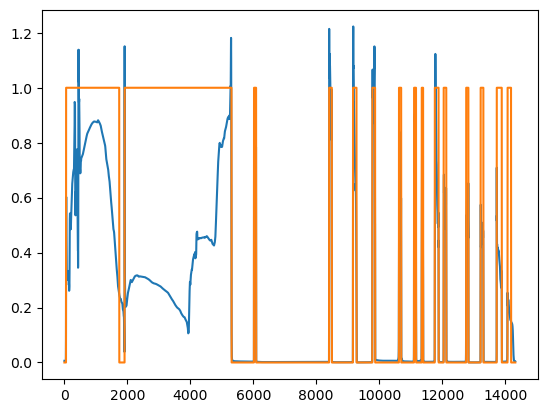

In [90]:
plt.plot(np.array(EF.factor2)/np.quantile(EF.factor2, 0.99))
plt.plot(np.array(EF_smooth.factor2))


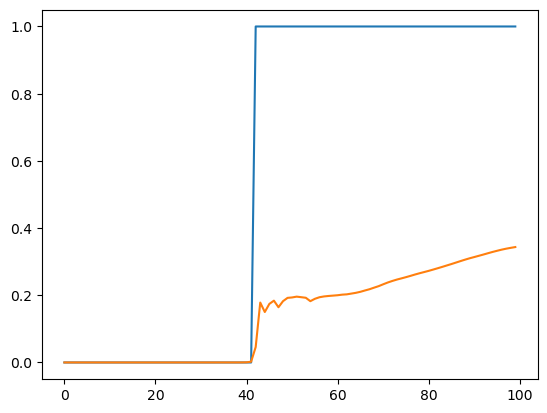

In [28]:
plt.plot(np.array(EF_smooth.factor1[2405:2505]))
plt.plot(np.array(EF.factor1[2405:2505])/np.max(EF.factor1))

In [59]:
EF_shift

,factor1,factor2
coords,,
chr6:36594369,-1.0,0.0
chr6:36594480,1.0,0.0
chr6:36596758,-1.0,-1.0
chr6:36596967,1.0,1.0
chr6:36598846,-1.0,0.0
chr6:36598982,1.0,0.0
chr6:36601143,-1.0,0.0
chr6:36601189,1.0,0.0
chr6:36601704,-1.0,0.0


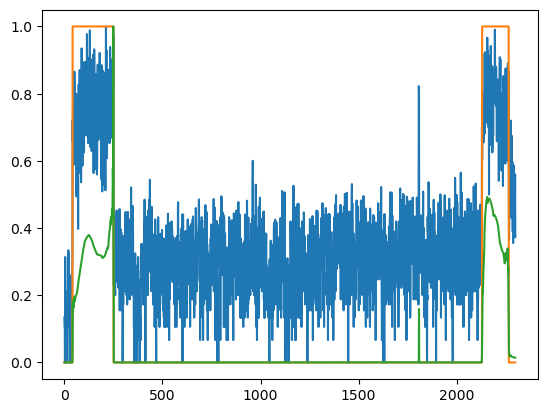

In [58]:
plt.plot(np.log1p(np.array(counts.sum(axis=0)))[2405:4705]/np.max(np.log1p(np.array(counts.sum(axis=0)))[2405:2705]))
plt.plot(np.array(EF_smooth.factor1[2405:4705]))
plt.plot(np.array(EF.factor1[2405:4705])/np.max(np.array(EF.factor1[2405:2705])))


In [14]:
36596835

36596835

In [15]:
counts.shape

(1000, 11338)

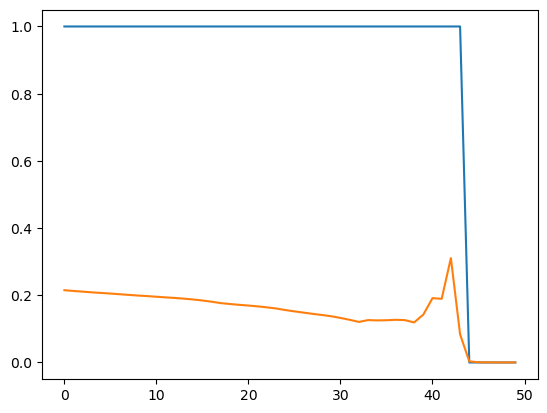

In [16]:
plt.plot(np.array(EF_smooth.factor1[125:175]))
plt.plot(np.array(EF.factor1[125:175])/np.max(EF.factor1))

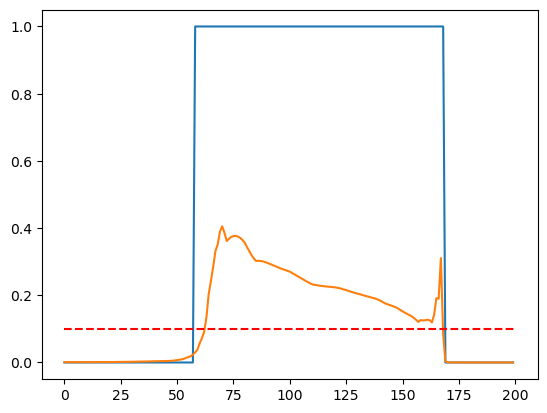

In [30]:
plt.plot(np.array(EF_smooth.factor1[:200]))
plt.plot(np.array(EF.factor1[:200])/np.max(EF.factor1))
plt.plot([0, 200], [0.1, 0.1], 'r--')

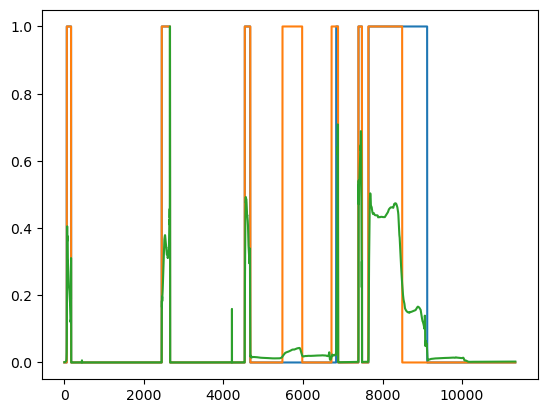

In [31]:
plt.plot(np.array(EF_smooth.factor1))
plt.plot(np.array(EF_smooth.factor2))

plt.plot(np.array(EF.factor1)/np.max(EF.factor1))


In [69]:
36594444 - 36594375

69

In [68]:
for record in juncs:
    print(record)

['chr6', '36594406', '36596835', 'JUNC00076001', '114', '+', '36594406', '36596835', '255,0,0', '2', '75,75', '0,2354']


In [44]:
EF_shift

,factor1,factor2
coords,,
chr6:36594375,-1.0,0.0
chr6:36594444,1.0,0.0
chr6:36594478,-1.0,0.0
chr6:36594479,1.0,0.0
chr6:36596776,-1.0,0.0
chr6:36596967,1.0,1.0
chr6:36598849,-1.0,-1.0
chr6:36598982,1.0,0.0
chr6:36601159,-1.0,0.0


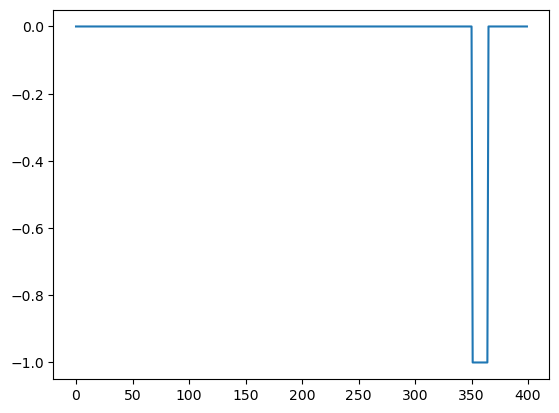

In [23]:
plt.plot((smooth_factor(EF.factor1) - smooth_factor(EF.factor2))[2100:2500])